# Spatio-Temporal Modeling with Convolutional Neural Networks

In this notebook, I will attempt to build a CNN model that will predict drought levels for all locations across the contiguous United States based on past data points. Each data point in the weekly time series consists of a rectangular grid where each point on the grid has an associated numerical value reflecting drought levels.

## Third Model
### X: 13 preceding data points in 4 week interval
### (4 weeks prior, 8 weeks prior, 12 weeks prior, ... , 52 weeks prior)
### 35 epochs

In [1]:
import pandas as pd
import numpy as np
import datetime as dt
import matplotlib.pyplot as plt

np.random.seed(42)

from sklearn.model_selection import train_test_split
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Conv2D, MaxPooling2D, Conv3D, MaxPooling3D
from keras.utils import np_utils

%matplotlib inline

Using TensorFlow backend.


In [2]:
drought_array = pd.read_csv("./data/drought_simplified_array.csv")

In [3]:
drought_array.drop(columns="Unnamed: 0", inplace=True)

In [4]:
drt = pd.read_csv("./data/drought_data_combined.csv")

drt.set_index("Date", inplace=True)

drt.index = pd.to_datetime(drt.index)

In [5]:
latitudes = [0.25*i for i in list(range(96, 201))]
latitudes.reverse()

longitudes = [0.25*i for i in list(range(-500, -263))]

dates = list(drt.index.unique().sort_values())

In [6]:
drought_3D = drought_array.values.reshape(len(dates), len(latitudes), len(longitudes))

In [7]:
drought_3D.shape

(1009, 105, 237)

In [8]:
drought_3D[52:].shape

(957, 105, 237)

In [9]:
X = np.array([])
for i in range(drought_3D[:-52].shape[0]):
    data_point = np.array([drought_3D[i+j] for j in range(0, 52, 4)])
    X = np.append(X, data_point)

In [10]:
X.shape

(309594285,)

In [11]:
X_matrix = X.reshape(957, 13, 105, 237, 1)

In [12]:
X_matrix.shape

(957, 13, 105, 237, 1)

In [13]:
105*237

24885

In [14]:
Y = drought_3D[52:].reshape(957, 24_885)

In [15]:
Y.shape

(957, 24885)

In [16]:
X_train = X_matrix[:700]
X_test  = X_matrix[700:]
Y_train = Y[:700]
Y_test  = Y[700:]

In [17]:
X_train.shape

(700, 13, 105, 237, 1)

In [18]:
X_test.shape

(257, 13, 105, 237, 1)

In [19]:
Y_train.shape

(700, 24885)

In [20]:
Y_test.shape

(257, 24885)

In [21]:
cnn_model = Sequential()

In [22]:
cnn_model.add(Conv3D(filters = 6,                # number of filters
                     kernel_size = (2, 12, 12),    # height/width of filter, could increase the 5,5
                     activation='relu',          # activation function 
                     input_shape=(13,105,237,1))) # shape of input

In [23]:
cnn_model.add(MaxPooling3D(pool_size=(1,4,4))) # dimensions of region of pooling

In [24]:
cnn_model.add(Conv3D(16,
                     kernel_size=(2, 12, 12),
                     activation='relu'))

In [25]:
cnn_model.add(MaxPooling3D(pool_size=(1,4,4)))

In [26]:
cnn_model.add(Flatten())

In [27]:
cnn_model.add(Dense(128, activation='relu'))

In [28]:
cnn_model.add(Dense(24_885, activation='linear'))

I found the function below from the following stack overflow page: https://stackoverflow.com/questions/45250100/kerasregressor-coefficient-of-determination-r2-score

It needs to be modified so that it cycles through the time series for each pixel out of the 24,885. I will work on correcting this moving forward. I have not been able to figure this out, so as it is now, the r2 scores that are displayed are erroneous. I'm not sure what they represent. The MSE and MAE metrics should be correct.

In [29]:
def r2_score(y_true, y_pred):
    from keras import backend as K
    SS_res =  K.sum(K.square( y_true-y_pred ))
    SS_tot = K.sum(K.square( y_true - K.mean(y_true) ) )
    return ( 1 - SS_res/(SS_tot + K.epsilon()) )

In [30]:
cnn_model.compile(loss='mean_squared_error',
                  optimizer='adam',
                  metrics=['mse', "mae", r2_score])

In [31]:
history = cnn_model.fit(X_train,
                        Y_train,
                        batch_size=256,
                        validation_data=(X_test, Y_test),
                        epochs=35,
                        verbose=1)

Train on 700 samples, validate on 257 samples
Epoch 1/35
700/700 [==============================] - 927s 1s/step - loss: 2.4882 - mean_squared_error: 2.4882 - mean_absolute_error: 0.7341 - r2_score: -0.2352 - val_loss: 1.4204 - val_mean_squared_error: 1.4204 - val_mean_absolute_error: 0.5796 - val_r2_score: -0.0011
Epoch 2/35
700/700 [==============================] - 901s 1s/step - loss: 1.8567 - mean_squared_error: 1.8567 - mean_absolute_error: 0.8086 - r2_score: 0.0818 - val_loss: 1.1585 - val_mean_squared_error: 1.1585 - val_mean_absolute_error: 0.5573 - val_r2_score: 0.1751
Epoch 3/35
700/700 [==============================] - 895s 1s/step - loss: 1.3978 - mean_squared_error: 1.3978 - mean_absolute_error: 0.6787 - r2_score: 0.3070 - val_loss: 1.2758 - val_mean_squared_error: 1.2758 - val_mean_absolute_error: 0.6986 - val_r2_score: 0.0420
Epoch 4/35
700/700 [==============================] - 895s 1s/step - loss: 1.2683 - mean_squared_error: 1.2683 - mean_absolute_error: 0.6805 - r2

In [32]:
cnn_model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv3d_1 (Conv3D)            (None, 12, 94, 226, 6)    1734      
_________________________________________________________________
max_pooling3d_1 (MaxPooling3 (None, 12, 23, 56, 6)     0         
_________________________________________________________________
conv3d_2 (Conv3D)            (None, 11, 12, 45, 16)    27664     
_________________________________________________________________
max_pooling3d_2 (MaxPooling3 (None, 11, 3, 11, 16)     0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 5808)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 128)               743552    
_________________________________________________________________
dense_2 (Dense)              (None, 24885)             3210165   
Total para

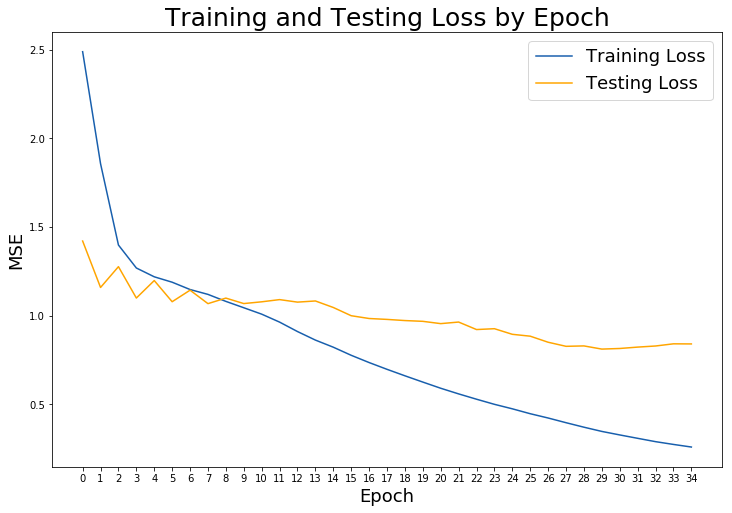

In [33]:
# Check out our train loss and test loss over epochs.
train_loss = history.history['loss']
test_loss = history.history['val_loss']

# Set figure size.
plt.figure(figsize=(12, 8))

# Generate line plot of training, testing loss over epochs.
plt.plot(train_loss, label='Training Loss', color='#185fad')
plt.plot(test_loss, label='Testing Loss', color='orange')

# Set title
plt.title('Training and Testing Loss by Epoch', fontsize = 25)
plt.xlabel('Epoch', fontsize = 18)
plt.ylabel('MSE', fontsize = 18)
plt.xticks(list(range(35)))

plt.legend(fontsize = 18);


In [35]:
# Evaluate model on test data.
cnn_score = cnn_model.evaluate(X_test,
                               Y_test,
                               verbose=1)

cnn_labels = cnn_model.metrics_names

# Compare models.

print(f'CNN 1 {cnn_labels[1]}  : {cnn_score[1]}')
print(f'CNN 1 {cnn_labels[2]}   : {cnn_score[2]}')
print(f'CNN 1 {cnn_labels[3]}   : {cnn_score[3]}')

print()

cnn_model.summary()

257/257 [==============================] - 48s 185ms/step
CNN 1 mean_squared_error  : 0.8400448736977485
CNN 1 mean_absolute_error   : 0.508813391863604
CNN 1 r2_score   : 0.24806297985032374

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv3d_1 (Conv3D)            (None, 12, 94, 226, 6)    1734      
_________________________________________________________________
max_pooling3d_1 (MaxPooling3 (None, 12, 23, 56, 6)     0         
_________________________________________________________________
conv3d_2 (Conv3D)            (None, 11, 12, 45, 16)    27664     
_________________________________________________________________
max_pooling3d_2 (MaxPooling3 (None, 11, 3, 11, 16)     0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 5808)              0         
_________________________________________________________________
dense_1 (Dense)

In [36]:
predictions = cnn_model.predict(X_test)

In [37]:
predictions.shape

(257, 24885)

In [52]:
from sklearn.metrics import r2_score

In [54]:
r2_score(Y_test, predictions)

-0.7535616593170281

In [55]:
r2_list = []
for true_value in Y_test:
    for prediction in predictions:
        r2 = r2_score(true_value, prediction)
        r2_list.append(r2)

In [56]:
np.mean(r2_list)

-0.47175144069674674

In [57]:
prediction_3D = predictions.reshape(257, 105, 237)

Animation size has reached 21033611 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


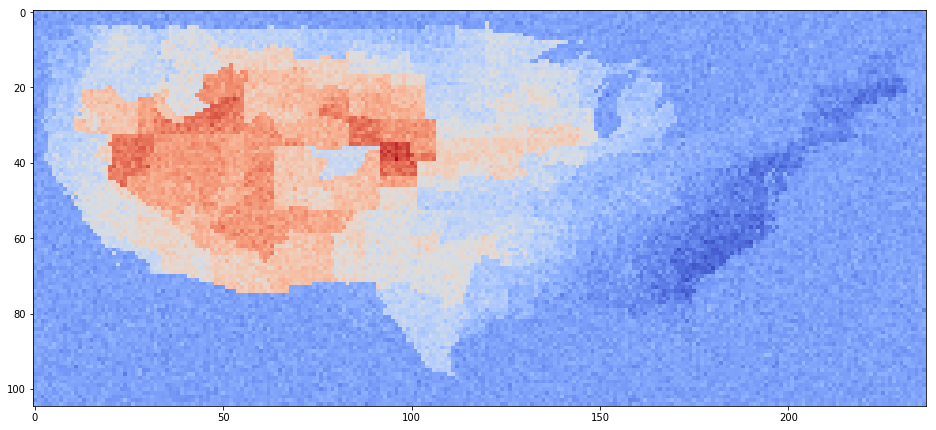

In [58]:
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(16, 12))

prediction_images = []
for i in range(len(prediction_3D)):
    prediction_image = plt.imshow(prediction_3D[i], animated=True, cmap="coolwarm")
    prediction_images.append([prediction_image])

ani = animation.ArtistAnimation(fig, prediction_images, interval=50, blit=True,
                                repeat_delay=1000)

# ani.save("./images/drought_data_timelapse.mp4")

from IPython.display import HTML
HTML(ani.to_jshtml())